## Saving and resetting states

In [1]:
import torch
from spikingjelly.activation_based import neuron

net_s = neuron.IFNode(step_mode='s')
x = torch.rand([4])
print(net_s)
print(f'the initial v={net_s.v}')
y = net_s(x)
print(f'x={x}')
print(f'y={y}')
print(f'v={net_s.v}')

IFNode(
  v_threshold=1.0, v_reset=0.0, detach_reset=False, step_mode=s, backend=torch
  (surrogate_function): Sigmoid(alpha=4.0, spiking=True)
)
the initial v=0.0
x=tensor([0.8416, 0.6797, 0.1417, 0.4452])
y=tensor([0., 0., 0., 0.])
v=tensor([0.8416, 0.6797, 0.1417, 0.4452])


After init, the V if IF layer neurons is set to 0 and made to have the same shape as its input.

if giving a new input sample we should clear the previous states of the neuron and reset it to the initialisation states using the self.reset() method or  spikingjelly.activation_based.functional.reset_net can be used to reset the entire net

In [3]:
import torch
from spikingjelly.activation_based import neuron

net_s = neuron.IFNode(step_mode='s')
x = torch.rand([4])
print(f'check point 0: v={net_s.v}')
y = net_s(x)
print(f'check point 1: v={net_s.v}')
net_s.reset()
print(f'check point 2: v={net_s.v}')
x = torch.rand([8])
y = net_s(x)
print(f'check point 3: v={net_s.v}')


check point 0: v=0.0
check point 1: v=tensor([0.3522, 0.9143, 0.8212, 0.3791])
check point 2: v=0.0
check point 3: v=tensor([0.0110, 0.8170, 0.2621, 0.4286, 0.8185, 0.4898, 0.3642, 0.7325])


# IMPORTANT NOTE

If the network uses one or more stateful modules, it must be reset after processing one batch of data during training and inference:

In [3]:
from spikingjelly.activation_based import functional
# ...
for x, label in tqdm(train_data_loader):
    # ...
    optimizer.zero_grad()
    y = net(x)
    loss = criterion(y, label)
    loss.backward()
    optimizer.step()


    functional.reset_net(net)
    # Never forget to reset the network!

NameError: name 'tqdm' is not defined

## Propagation patterns

if all modules in the network are single-step then the computation graph of the network is built step by step:



In [1]:
for t in range(T):
    x = x_seq[t]
    y = net(x)
    y_seq_step_by_step.append(y.unsqueeze(0))

y_seq_step_by_step = torch.cat(y_seq_step_by_step, 0)

NameError: name 'T' is not defined

if all modules in the network are multistep then the computation graph of the network is built layer by layer.

In [ ]:
import torch
import torch.nn as nn
from spikingjelly.activation_based import neuron, functional, layer
T = 4
N = 2
C = 8
x_seq = torch.rand([T, N, C]) * 64.

net = nn.Sequential(
    layer.Linear(C, 4),
    neuron.IFNode(),
    layer.Linear(4, 2),
    neuron.IFNode()
)

functional.set_step_mode(net, step_mode='m')
with torch.no_grad():
    y_seq_layer_by_layer = x_seq
    for i in range(net.__len__()):
        y_seq_layer_by_layer = net[i](y_seq_layer_by_layer)

The only difference between these 2 methods is the order in whicn the compuation graph is built. the output of is identical:

In [5]:
import torch
import torch.nn as nn
from spikingjelly.activation_based import neuron, functional, layer
T = 4
N = 2
C = 3
H = 8
W = 8
x_seq = torch.rand([T, N, C, H, W]) * 64.

net = nn.Sequential(
layer.Conv2d(3, 8, kernel_size=3, padding=1, stride=1, bias=False),
neuron.IFNode(),
layer.MaxPool2d(2, 2),
neuron.IFNode(),
layer.Flatten(start_dim=1),
layer.Linear(8 * H // 2 * W // 2, 10),
neuron.IFNode(),
)

print(f'net={net}')

with torch.no_grad():
    y_seq_step_by_step = []
    for t in range(T):
        x = x_seq[t]
        y = net(x)
        y_seq_step_by_step.append(y.unsqueeze(0))

    y_seq_step_by_step = torch.cat(y_seq_step_by_step, 0)
    # we can also use `y_seq_step_by_step = functional.multi_step_forward(x_seq, net)` to get the same results

    print(f'y_seq_step_by_step=\n{y_seq_step_by_step}')

    functional.reset_net(net)
    functional.set_step_mode(net, step_mode='m')
    y_seq_layer_by_layer = net(x_seq)

    max_error = (y_seq_layer_by_layer - y_seq_step_by_step).abs().max()
    print(f'max_error={max_error}')

net=Sequential(
  (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False, step_mode=s)
  (1): IFNode(
    v_threshold=1.0, v_reset=0.0, detach_reset=False, step_mode=s, backend=torch
    (surrogate_function): Sigmoid(alpha=4.0, spiking=True)
  )
  (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False, step_mode=s)
  (3): IFNode(
    v_threshold=1.0, v_reset=0.0, detach_reset=False, step_mode=s, backend=torch
    (surrogate_function): Sigmoid(alpha=4.0, spiking=True)
  )
  (4): Flatten(start_dim=1, end_dim=-1, step_mode=s)
  (5): Linear(in_features=128, out_features=10, bias=True)
  (6): IFNode(
    v_threshold=1.0, v_reset=0.0, detach_reset=False, step_mode=s, backend=torch
    (surrogate_function): Sigmoid(alpha=4.0, spiking=True)
  )
)
y_seq_step_by_step=
tensor([[[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
         [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]],

        [[0., 0., 0., 1., 0., 0., 0., 0., 0., 0.],
         [0., 0., 0., 1., 0

## Container

3 basic kinds:

- multi_step_forward in functional style and MultiStepContainer in module style


- seq_to_ann_forward in functional style and SeqToANNContainer in module style


- StepModeContainer for wrapping a single-step module for single/multi-step propagation


multi_step_forward can use a single-step module to implement multi-step propagation, and MultiStepContainer can wrap a single-step module to a multi-step module. For example:

In [ ]:
import torch
from spikingjelly.activation_based import neuron, functional, layer

net_s = neuron.IFNode(step_mode='s')
T = 4
N = 1
C = 3
H = 8
W = 8
x_seq = torch.rand([T, N, C, H, W])
y_seq = functional.multi_step_forward(x_seq, net_s)
# y_seq.shape = [T, N, C, H, W]

net_s.reset()
net_m = layer.MultiStepContainer(net_s)
z_seq = net_m(x_seq)
# z_seq.shape = [T, N, C, H, W]

# z_seq is identical to y_seq

Stateless ANN layers should be wrapped in multi-step containers to be used in multistep mode:

In [ ]:
import torch
import torch.nn as nn
from spikingjelly.activation_based import functional, layer

with torch.no_grad():
    T = 4
    N = 1
    C = 3
    H = 8
    W = 8
    x_seq = torch.rand([T, N, C, H, W])

    conv = nn.Conv2d(C, 8, kernel_size=3, padding=1, bias=False)
    bn = nn.BatchNorm2d(8)

    y_seq = functional.multi_step_forward(x_seq, (conv, bn))
    # y_seq.shape = [T, N, 8, H, W]

    net = layer.MultiStepContainer(conv, bn)
    z_seq = net(x_seq)
    # z_seq.shape = [T, N, 8, H, W]

    # z_seq is identical to y_seq

This however is inefficient as the stateless layers do not need step by step calculation. this is where  seq_to_ann_forward or SeqToANNContainer can be used. these containers reshape the input with shape = [T, N, *] to shape = [TN, *], send data to ann layers, and reshape output to shape = [T, N, *]

In [ ]:
import torch
import torch.nn as nn
from spikingjelly.activation_based import functional, layer

with torch.no_grad():
    T = 4
    N = 1
    C = 3
    H = 8
    W = 8
    x_seq = torch.rand([T, N, C, H, W])

    conv = nn.Conv2d(C, 8, kernel_size=3, padding=1, bias=False)
    bn = nn.BatchNorm2d(8)

    y_seq = functional.multi_step_forward(x_seq, (conv, bn))
    # y_seq.shape = [T, N, 8, H, W]

    net = layer.MultiStepContainer(conv, bn)
    z_seq = net(x_seq)
    # z_seq.shape = [T, N, 8, H, W]

    # z_seq is identical to y_seq

    p_seq = functional.seq_to_ann_forward(x_seq, (conv, bn))
    # p_seq.shape = [T, N, 8, H, W]

    net = layer.SeqToANNContainer(conv, bn)
    q_seq = net(x_seq)
    # q_seq.shape = [T, N, 8, H, W]

    # q_seq is identical to p_seq, and also identical to y_seq and z_seq

## Neurons

Spiking neurons are defined as neurons that can only output spikes whose elements are 1 or 0

as an example lets firstly look at the IFNode neuron:

In [3]:
import torch
from spikingjelly.activation_based import neuron
from spikingjelly import visualizing
from matplotlib import pyplot as plt

In [4]:
if_layer = neuron.IFNode()

Some of the basic parameters of the IF neuron are:

- V_threshold - (selfexplan)
- V_reset - the reset voltage of this neurons layer. If not None, the neurons voltage will be set to v_reset. after firing a spike, if none, the neurons voltagee will subtract v_thresholld after firing a spike
- Surrogate function - the function for calculating surrogater gradients of the heaviside step function in backward

The number of neuron in the layer is automatically defined by the shape of the input after the init of the layer or after reset() is called

Similar to RNNs, spiking neurons can be considered as stateful but rather than it being the hidden state of the neuron it is the membrane potential of the neuron. The membrane potential is a tensor with the same shape as the input. The membrane potential is initialised to 0 after the init of the layer or after reset() is called

In [5]:
print(if_layer.v)
# if_layer.v=0.0



0.0


In [6]:
x = torch.rand(size=[2, 3])
if_layer(x)
print(f'x.shape={x.shape}, if_layer.v.shape={if_layer.v.shape}')
# x.shape=torch.Size([2, 3]), if_layer.v.shape=torch.Size([2, 3])
if_layer.reset() # reset the neuron

x = torch.rand(size=[4, 5, 6])
if_layer(x)
print(f'x.shape={x.shape}, if_layer.v.shape={if_layer.v.shape}')
# x.shape=torch.Size([4, 5, 6]), if_layer.v.shape=torch.Size([4, 5, 6])
if_layer.reset()


x.shape=torch.Size([2, 3]), if_layer.v.shape=torch.Size([2, 3])
x.shape=torch.Size([4, 5, 6]), if_layer.v.shape=torch.Size([4, 5, 6])


## Sub-threshold Dynamics of an Integrate-and-Fire Neuron

The sub-threshold dynamics of an integrate-and-fire (IF) neuron are modeled by the continuous-time differential equation:

$$\[ \frac{dV(t)}{dt} = f(V(t), X(t)) \]$$


where:

- \( V(t) \) is the membrane potential at time \( t \).
- \( X(t) \) is the external input to the neuron at time \( t \).
- \( f \) is a function describing how the membrane potential changes in response to the external input.

For an IF neuron, the charging function is simplified to:

$$\[ \frac{dV(t)}{dt} = X(t) \]$$

This signifies that the rate of change of the membrane potential is directly proportional to the external input.

Since we cannot directly simulate a continuous function in a computational model, we use a discrete-time difference equation to approximate the continuous dynamics:

$$\[ V[t] = V[t - 1] + X[t] \]$$

This discrete-time equation indicates that the membrane potential at the current time step $\( V[t] \)$ is the sum of the membrane potential at the previous time step $\( V[t - 1] \)$ and the external input $\( X[t] \)$


# Describing the Spiking Dynamics of a Neuron

the dynamics of a spiking neuron can be described by the following equations:

the neuronal charge and fire:

<math xmlns="http://www.w3.org/1998/Math/MathML" display="block">
  <mtable displaystyle="true" columnalign="right left" columnspacing="0em" rowspacing="3pt">
    <mtr>
      <mtd>
        <mi>H</mi>
        <mo stretchy="false">[</mo>
        <mi>t</mi>
        <mo stretchy="false">]</mo>
      </mtd>
      <mtd>
        <mi></mi>
        <mo>=</mo>
        <mi>f</mi>
        <mo stretchy="false">(</mo>
        <mi>V</mi>
        <mo stretchy="false">[</mo>
        <mi>t</mi>
        <mo>&#x2212;</mo>
        <mn>1</mn>
        <mo stretchy="false">]</mo>
        <mo>,</mo>
        <mi>X</mi>
        <mo stretchy="false">[</mo>
        <mi>t</mi>
        <mo stretchy="false">]</mo>
        <mo stretchy="false">)</mo>
      </mtd>
    </mtr>
    <mtr>
      <mtd>
        <mi>S</mi>
        <mo stretchy="false">[</mo>
        <mi>t</mi>
        <mo stretchy="false">]</mo>
      </mtd>
      <mtd>
        <mi></mi>
        <mo>=</mo>
        <mi mathvariant="normal">&#x398;</mi>
        <mo stretchy="false">(</mo>
        <mi>H</mi>
        <mo stretchy="false">[</mo>
        <mi>t</mi>
        <mo stretchy="false">]</mo>
        <mo>&#x2212;</mo>
        <msub>
          <mi>V</mi>
          <mrow data-mjx-texclass="ORD">
            <mi>t</mi>
            <mi>h</mi>
            <mi>r</mi>
            <mi>e</mi>
            <mi>s</mi>
            <mi>h</mi>
            <mi>o</mi>
            <mi>l</mi>
            <mi>d</mi>
          </mrow>
        </msub>
        <mo stretchy="false">)</mo>
      </mtd>
    </mtr>
  </mtable>
</math>

where <math xmlns="http://www.w3.org/1998/Math/MathML">
  <mi mathvariant="normal">&#x398;</mi>
  <mo stretchy="false">(</mo>
  <mi>x</mi>
  <mo stretchy="false">)</mo>
</math> is the Heaviside step function, and <math xmlns="http://www.w3.org/1998/Math/MathML">
  <msub>
    <mi>V</mi>
    <mrow data-mjx-texclass="ORD">
      <mi>t</mi>
      <mi>h</mi>
      <mi>r</mi>
      <mi>e</mi>
      <mi>s</mi>
      <mi>h</mi>
      <mi>o</mi>
      <mi>l</mi>
      <mi>d</mi>
    </mrow>
  </msub>


the hard reset function: <math xmlns="http://www.w3.org/1998/Math/MathML" display="block">
  <mi>V</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
  <mo>=</mo>
  <mi>H</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
  <mo>&#x22C5;</mo>
  <mo stretchy="false">(</mo>
  <mn>1</mn>
  <mo>&#x2212;</mo>
  <mi>S</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
  <mo stretchy="false">)</mo>
  <mo>+</mo>
  <msub>
    <mi>V</mi>
    <mrow data-mjx-texclass="ORD">
      <mi>r</mi>
      <mi>e</mi>
      <mi>s</mi>
      <mi>e</mi>
      <mi>t</mi>
    </mrow>
  </msub>
  <mo>&#x22C5;</mo>
  <mi>S</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
</math>

the soft reset function:
<math xmlns="http://www.w3.org/1998/Math/MathML" display="block">
  <mi>V</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
  <mo>=</mo>
  <mi>H</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
  <mo>&#x2212;</mo>
  <msub>
    <mi>V</mi>
    <mrow data-mjx-texclass="ORD">
      <mi>t</mi>
      <mi>h</mi>
      <mi>r</mi>
      <mi>e</mi>
      <mi>s</mi>
      <mi>h</mi>
      <mi>o</mi>
      <mi>l</mi>
      <mi>d</mi>
    </mrow>
  </msub>
  <mo>&#x22C5;</mo>
  <mi>S</mi>
  <mo stretchy="false">[</mo>
  <mi>t</mi>
  <mo stretchy="false">]</mo>
</math>

# Simulation

lets do some plotting of the output of the IF neuron

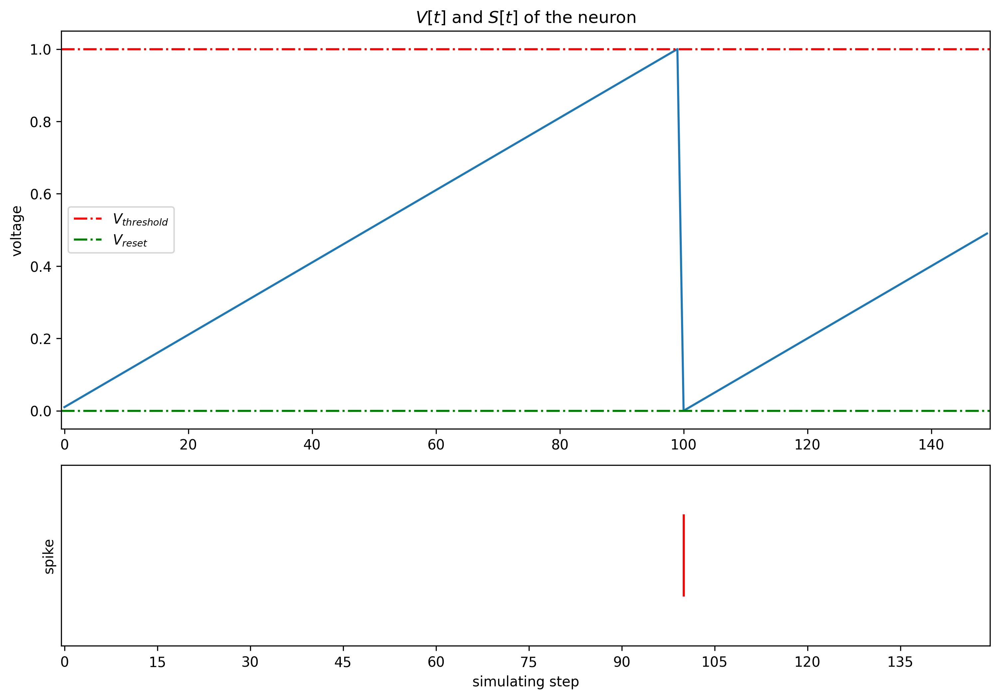

In [7]:
if_layer.reset()
x = torch.as_tensor([0.01])
T = 150
s_list = []
v_list = []
for t in range(T):
    s_list.append(if_layer(x))
    v_list.append(if_layer.v)

dpi = 300
figsize = (12, 8)
visualizing.plot_one_neuron_v_s(torch.cat(v_list).numpy(), torch.cat(s_list).numpy(), v_threshold=if_layer.v_threshold,
                                v_reset=if_layer.v_reset,
                                figsize=figsize, dpi=dpi)
plt.show()

Now lets try changing the threshold and reset voltage.

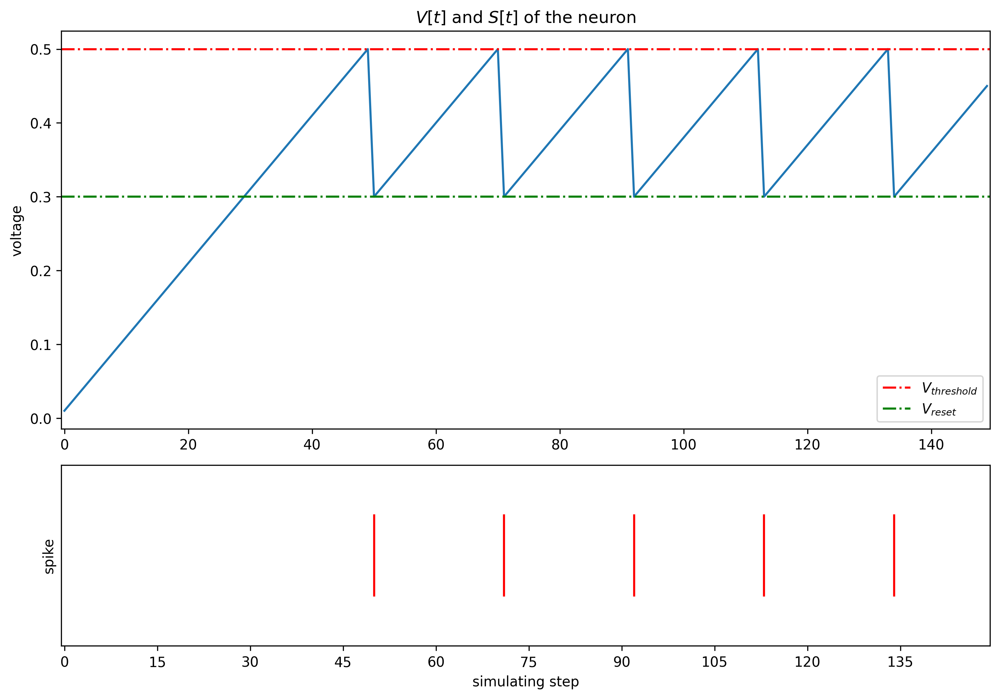

In [11]:
if_layer.reset()
if_layer.v_threshold = 0.5 # change the threshold
if_layer.v_reset = 0.3 # change the reset voltage
x = torch.as_tensor([0.01])
T = 150
s_list = []
v_list = []
for t in range(T):
    s_list.append(if_layer(x))
    v_list.append(if_layer.v)

dpi = 300
figsize = (12, 8)
visualizing.plot_one_neuron_v_s(torch.cat(v_list).numpy(), torch.cat(s_list).numpy(), v_threshold=if_layer.v_threshold,
                                v_reset=if_layer.v_reset,
                                figsize=figsize, dpi=dpi)
plt.show()

Let's now try with a larger input. remembering to reset the neuron first

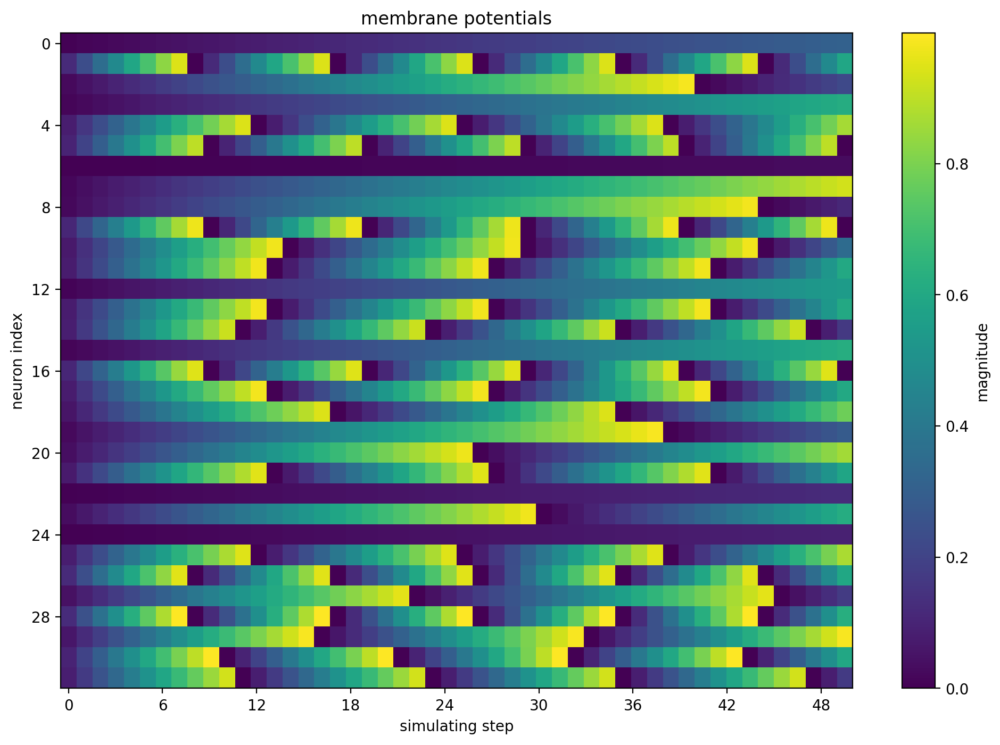

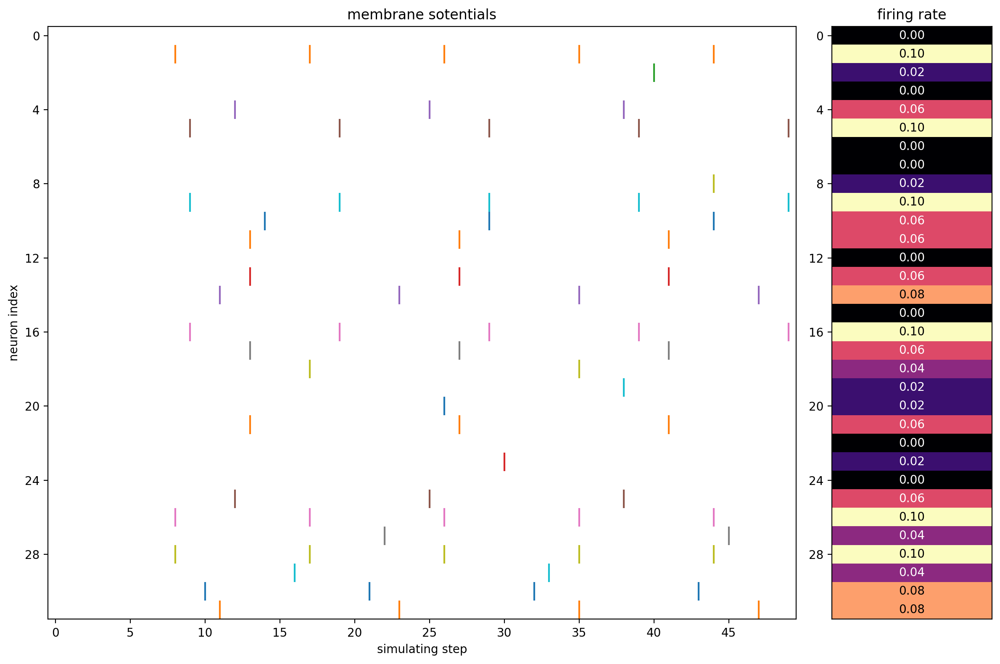

In [9]:
if_layer.reset()
T = 50
x = torch.rand([32]) / 8.
s_list = []
v_list = []
for t in range(T):
    s_list.append(if_layer(x).unsqueeze(0))
    v_list.append(if_layer.v.unsqueeze(0))

s_list = torch.cat(s_list)
v_list = torch.cat(v_list)

figsize = (12, 8)
dpi = 200
visualizing.plot_2d_heatmap(array=v_list.numpy(), title='membrane potentials', xlabel='simulating step',
                            ylabel='neuron index', int_x_ticks=True, x_max=T, figsize=figsize, dpi=dpi)


visualizing.plot_1d_spikes(spikes=s_list.numpy(), title='membrane sotentials', xlabel='simulating step',
                        ylabel='neuron index', figsize=figsize, dpi=dpi)

plt.show()

# Custom Neurons



To define a custom neuron, we need to inherit the base class neuron.NeuronBase the single step forward function from the base class is comprised of 3 parts:



In [ ]:
# spikingjelly.activation_based.neuron.BaseNode
def single_step_forward(self, x: torch.Tensor):
    self.neuronal_charge(x)
    spike = self.neuronal_fire()
    self.neuronal_reset(spike)
    return spike

If we want to build a square-integrate-and-fire (SIF) neuron, we can define a class SIFNode as follows:


In [ ]:
import torch
from spikingjelly.activation_based import neuron

class SIFNode(neuron.BaseNode):
    def neuronal_charge(self, x):
        self.v += x ** 2


# Surrogate Gradients

Training SNNs is challenging due to the nature of spikes, which are discrete and non-differentiable. This makes it difficult to apply traditional gradient-based learning methods directly, as they rely on the ability to calculate gradients of the loss function with respect to the network parameters. Since the output of a spiking neuron is a series of spikes (essentially a series of 0s and 1s indicating whether a neuron fired at a particular time), the derivative of this output with respect to the neuron inputs or weights is zero almost everywhere, which leads to the problem known as the "dead gradient" problem.

One of the solutions to this problem is the surrogate gradient metthod. The main idea of this method is to approximate the non-differentiable spike train with differentiable "surrogate" function during the backward pass in backpropagation

##steps

1. forward pass - calculate the output of the neuron in normal io fashion
2. backward pass - calculate the gradient of the loss function with respect to the neuron inputs or weights using the surrogate gradient of the neuron. The surrogate gradient is calculated according to the surrogate function used. some examples functions include piecewise linear function, sigmoid function, and softplus function. the derivative of these functions are continuous and non-zero everywhere, which allows the gradient to be backpropagated through the neuron.
3. weight update - this can then be used to update the weights of the network using gradient descent.
4. repeat steps 1-3 until the network converges.

## Code example

The surrogate function can be found in BaseNode.neuronal_fire



x=tensor([ 0.2512, -0.3117, -0.2033,  0.0440,  0.2758, -0.0919, -0.0324,  0.1669],
       requires_grad=True)
y=tensor([1., 0., 0., 1., 1., 0., 0., 1.], grad_fn=<sigmoidBackward>)
x.grad=tensor([0.7847, 0.6936, 0.8514, 0.9923, 0.7483, 0.9670, 0.9958, 0.8963])


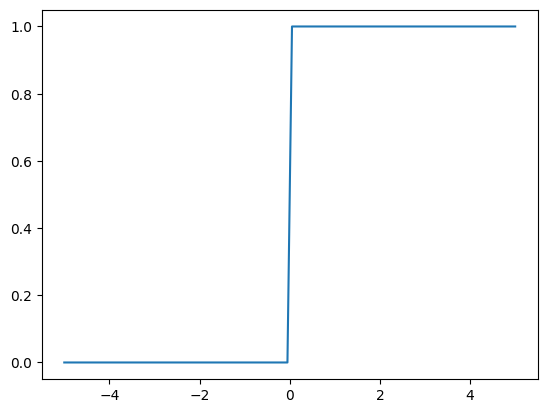

In [6]:
import torch
from spikingjelly.activation_based import surrogate
import matplotlib.pyplot as plt

sg = surrogate.Sigmoid(alpha=4.)

x = torch.rand([8]) - 0.5
x.requires_grad = True
y = sg(x)
y.sum().backward()
print(f'x={x}')
print(f'y={y}')
print(f'x.grad={x.grad}')
# plot the surrogate function
x = torch.linspace(-5, 5, 100)
y = sg(x)

plt.plot(x.numpy(), y.numpy())
plt.show()



# Single fully-connected SNN for MNIST classification

Lets start with an ANN example:

In [7]:
import torch.nn as nn

nn.Sequential(
    nn.Flatten(),
    nn.Linear(28 * 28, 10, bias=False),
    nn.Softmax()
)

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=784, out_features=10, bias=False)
  (2): Softmax(dim=None)
)

A SNN with the same structure can be built by replacing all activation functions with LIF neurons and packaging the connections between neurons with spikingjelly.activation_based.layer

In [25]:
import time
import torchvision
import numpy as np
import datetime
import torch.nn as nn
import torch.nn.functional as F
from spikingjelly.clock_driven import neuron, layer, encoding
from spikingjelly.activation_based import surrogate, layer, functional
from torch.cuda import amp



import torch.utils.data as data

data_dir = './data'

tau = 2.0
lr=1e-3
T=100
batch_size=64

net = nn.Sequential(
    layer.Flatten(),
    layer.Linear(28 * 28, 10, bias=False),
    neuron.LIFNode(tau=tau, surrogate_function= surrogate.ATan())
)

# Training

We will use the Adam optimizer and a poisson encoding to convert the input to spikes.

In [26]:


optimizer  = torch.optim.Adam(net.parameters(), lr=lr)
encoder = encoding.PoissonEncoder()


epochs = 100
start_epoch = 0

scaler = amp.GradScaler()

train_dataset = torchvision.datasets.MNIST(
        root=data_dir,
        train=True,
        transform=torchvision.transforms.ToTensor(),
        download=True
    )
test_dataset = torchvision.datasets.MNIST(
        root=data_dir,
        train=False,
        transform=torchvision.transforms.ToTensor(),
        download=True
    )

train_data_loader = data.DataLoader(
        dataset=train_dataset,
        batch_size=batch_size,
        shuffle=True,
        drop_last=True,
        num_workers=4,
        pin_memory=True
    )
test_data_loader = data.DataLoader(
        dataset=test_dataset,
        batch_size=batch_size,
        shuffle=False,
        drop_last=False,
        num_workers=4,
        pin_memory=True
    )
device = 'cpu'
net.to(device)


/Users/remi/Documents/PhD/NLP/SpikingExp/lib/python3.9/site-packages/torch/cuda/amp/grad_scaler.py:120: UserWarning: torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.
  warnings.warn("torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.")


Sequential(
  (0): Flatten(start_dim=1, end_dim=-1, step_mode=s)
  (1): Linear(in_features=784, out_features=10, bias=False)
  (2): LIFNode(
    v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
    (surrogate_function): ATan(alpha=2.0, spiking=True)
  )
)

## Notes on training SNNs

-  The output of a SNN is binary and is easily purturbed by noise caused by coding. Therefore it is more usual to consider the firing rate of th output layer within a certain time window as the output of the SNN. The value of the firing rate represents the response intensity of the corresponding category. So we should run the SNN for a certain time frame $T$ and the average firing rate as classification information.
- The ideal is for the proper neurons firing at the highest rate, the other neurons keep silent. Cross-entropy loss or MSE loss is often used. Here we use MSE loss for its better effect.
- After each network simulation, the network state should be reset by functional.reset_net(net).

In [27]:
for epoch in range(start_epoch, epochs):
    start_time = time.time()
    net.train()
    train_loss = 0
    train_acc = 0
    train_samples = 0
    for img, label in train_data_loader:
        optimizer.zero_grad()
        img = img.to(device)
        label = label.to(device)
        label_onehot = F.one_hot(label, 10).float()

        # Mixed-precision training
        if scaler is not None:
            with amp.autocast():
                out_fr = 0.
                # Run T time steps
                for t in range(T):
                    encoded_img = encoder(img)
                    out_fr += net(encoded_img)
                out_fr = out_fr /T
                # out_fr is tensor whose shape is [batch_size, 10]
                # The firing rate of 10 neurons in the output layer was recorded during the whole simulation period
                loss = F.mse_loss(out_fr, label_onehot)
                # The loss function is the MSE between the firing rate of the output layer and the true category.
                # The loss function will cause the firing rate of the correct neuron in the output layer to approach 1 when the label i is given, and the firing rate of the other neurons to approach 0.
            scaler.scale(loss).backward(retain_graph=True)
            scaler.step(optimizer)
            scaler.update()
        else:
            out_fr = 0.
            for t in range(T):
                encoded_img = encoder(img)
                out_fr += net(encoded_img)
            out_fr = out_fr / T
            loss = F.mse_loss(out_fr, label_onehot)
            loss.backward()
            optimizer.step()

        train_samples += label.numel()
        train_loss += loss.item() * label.numel()
        # The correct rate is calculated as follows. The subscript i of the neuron with the highest firing rate in the output layer is considered as the result of classification.
        train_acc += (out_fr.argmax(1) == label).float().sum().item()

        # After optimizing the parameters, the state of the network should be reset because the neurons of the SNN have “memory”.
        functional.reset_net(net)

/Users/remi/Documents/PhD/NLP/SpikingExp/lib/python3.9/site-packages/torch/amp/autocast_mode.py:204: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn('User provided device_type of \'cuda\', but CUDA is not available. Disabling')
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_t

In [28]:
train_time = time.time()
train_speed = train_samples / (train_time - start_time)
train_loss /= train_samples
train_acc /= train_samples

net.eval()
test_loss = 0
test_acc = 0
test_samples = 0
with torch.no_grad():
    for img, label in test_data_loader:
        img = img.to(device)
        label = label.to(device)
        label_onehot = F.one_hot(label, 10).float()
        out_fr = 0.
        for t in range(T):
            encoded_img = encoder(img)
            out_fr += net(encoded_img)
        out_fr = out_fr /T
        loss = F.mse_loss(out_fr, label_onehot)

        test_samples += label.numel()
        test_loss += loss.item() * label.numel()
        test_acc += (out_fr.argmax(1) == label).float().sum().item()
        functional.reset_net(net)
test_time = time.time()
test_speed = test_samples / (test_time - train_time)
test_loss /= test_samples
test_acc /= test_samples

  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=True)
), which is not spikingjelly.activation_based.base.MemoryModule
  v_threshold=1.0, v_reset=0.0, detach_reset=False, tau=2.0
  (surrogate_function): ATan(alpha=2.0, spiking=Tr

In [31]:
#plot loss using matplotlib
import datetime
max_test_acc = -1


print(f'epoch ={epoch}, train_loss ={train_loss: .4f}, train_acc ={train_acc: .4f}, test_loss ={test_loss: .4f}, test_acc ={test_acc: .4f}, max_test_acc ={max_test_acc: .4f}')
print(f'train speed ={train_speed: .4f} images/s, test speed ={test_speed: .4f} images/s')
print(f'escape time = {(datetime.datetime.now() + datetime.timedelta(seconds=(time.time() - start_time) * (epochs - epoch))).strftime("%Y-%m-%d %H:%M:%S")}\n')

train_loss /= train_samples
train_acc /= train_samples
print(f'Epoch {epoch} train loss: {train_loss:.4f}, train acc: {train_acc:.4f}, time: {time.time() - start_time:.2f}s')


epoch =99, train_loss = 0.0134, train_acc = 0.9345, test_loss = 0.0145, test_acc = 0.9274, max_test_acc =-1.0000
train speed = 4.7638 images/s, test speed = 645.1342 images/s
escape time = 2024-02-03 05:26:56

Epoch 99 train loss: 0.0000, train acc: 0.0000, time: 75572.60s
